<a href="https://colab.research.google.com/github/wiatrak2/BScThesis/blob/master/DimensionalityReduction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Load data


In [1]:
from google.colab import drive
drive.mount('/content/drive')
import sys
sys.path.append('BScThesis/')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [2]:
!pip3 install torch torchvision

    100% |████████████████████████████████| 591.8MB 30kB/s 
tcmalloc: large alloc 1073750016 bytes == 0x60a1a000 @  0x7f76b544d2a4 0x591a07 0x5b5d56 0x502e9a 0x506859 0x502209 0x502f3d 0x506859 0x504c28 0x502540 0x502f3d 0x506859 0x504c28 0x502540 0x502f3d 0x506859 0x504c28 0x502540 0x502f3d 0x507641 0x502209 0x502f3d 0x506859 0x504c28 0x502540 0x502f3d 0x507641 0x504c28 0x502540 0x502f3d 0x507641
    100% |████████████████████████████████| 61kB 22.2MB/s 
    100% |████████████████████████████████| 2.0MB 6.0MB/s 
  Found existing installation: Pillow 4.0.0
    Uninstalling Pillow-4.0.0:
      Successfully uninstalled Pillow-4.0.0


In [3]:
!git clone https://github.com/wiatrak2/BScThesis

Cloning into 'BScThesis'...
remote: Enumerating objects: 20, done.
remote: Counting objects: 100% (20/20), done.
remote: Compressing objects: 100% (15/15), done.
remote: Total 370 (delta 8), reused 13 (delta 5), pack-reused 350
Receiving objects: 100% (370/370), 56.73 MiB | 11.15 MiB/s, done.
Resolving deltas: 100% (212/212), done.


In [0]:
from importlib import reload 

In [0]:
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

In [0]:
import torchvision
import torchvision.transforms as transforms

In [0]:
import matplotlib.pyplot as plt
import pickle
import sympy
from collections import defaultdict, namedtuple
import copy

In [0]:
from mnist_m import Mnist_M
from random_dataset import RandomDataset
import datasets_merge
import models
import svhn_models
import trainer
import domain_trainer
from test_model import test_model
import plots
import test
import plotly_plots

In [0]:
import plotly
from plotly import tools
from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objs as go

In [0]:
from sklearn.decomposition import PCA, KernelPCA, TruncatedSVD, FactorAnalysis
from sklearn.manifold import TSNE

In [0]:
def convertMnist(img):
  img = img.squeeze().numpy()
  return torch.from_numpy(np.tile(img, (3,1,1)))

In [0]:
batch_size=128
num_workers=1

In [11]:
mnist_transform=transforms.Compose([
                           transforms.ToTensor(),
                           transforms.Normalize((0.1307, 0.1307, 0.1307), (0.3081, 0.3081, 0.3081)),
                           transforms.Lambda(convertMnist)
                       ])

mnist_train_set = torchvision.datasets.MNIST(root='./data', train=True, download=True,
                                     transform=mnist_transform)
mnist_train_loader = torch.utils.data.DataLoader(mnist_train_set, batch_size=batch_size,
                                         shuffle=True, num_workers=num_workers)

mnist_test_set = torchvision.datasets.MNIST(root='./data', train=False, download=True,
                                     transform=mnist_transform)
mnist_test_loader = torch.utils.data.DataLoader(mnist_test_set, batch_size=batch_size,
                                         shuffle=False, num_workers=num_workers)






Processing...
Done!


In [0]:
mnist_m_transform = transforms.Compose([
                           transforms.Normalize((0.1307, 0.1307, 0.1307), (0.3081, 0.3081, 0.3081)),
                       ])
mnist_m_train_set = Mnist_M('drive/My Drive/BScThesis/keras_mnistm.pkl',
                        transform=mnist_m_transform)
mnist_m_test_set = Mnist_M('drive/My Drive/BScThesis/keras_mnistm.pkl',train=False,
                     transform=mnist_m_transform)
mnist_m_train_loader = torch.utils.data.DataLoader(mnist_m_train_set, 
                                                   batch_size=batch_size,
                                         shuffle=True, num_workers=num_workers)
mnist_m_test_loader = torch.utils.data.DataLoader(mnist_m_test_set,
                                                  batch_size=batch_size,
                                         shuffle=False, num_workers=num_workers)

In [0]:
merge_train_set = datasets_merge.Merge_Datasets([mnist_train_set, mnist_m_train_set], get_labels=False)
merge_test_set = datasets_merge.Merge_Datasets([mnist_test_set, mnist_m_test_set], get_labels=False)
merge_train_loader = torch.utils.data.DataLoader(merge_train_set, 
                                                   batch_size=batch_size,
                                         shuffle=True, num_workers=num_workers)
merge_test_loader = torch.utils.data.DataLoader(merge_test_set, 
                                                   batch_size=batch_size,
                                         shuffle=True, num_workers=num_workers)

In [0]:
log_interval = 100

In [0]:
use_cuda = True
use_cuda = use_cuda and torch.cuda.is_available()
device = torch.device("cuda" if use_cuda else "cpu")

In [0]:
lr = 0.01
momentum=0.9

In [0]:
Models = namedtuple('Models', ['model_f', 'model_c', 'model_d'])
Optims = namedtuple('Optims', ['optim_f', 'optim_c', 'optim_d'])
Criterions = namedtuple('Criterions', ['criterion', 'criterion_domain'])
Loaders = namedtuple('Loaders', ['train_loader', 'train_loader_domain',
                                'source_test_loader', 'target_test_loader',
                                'merged_test_loader'])

In [0]:
loaders = Loaders(mnist_train_loader, mnist_m_train_loader,
                 mnist_test_loader, mnist_m_test_loader, merge_test_loader)

In [0]:
criterion = F.nll_loss
criterion_domain = F.nll_loss

In [0]:
criterions = Criterions(criterion, criterion_domain)

In [0]:
epochs=10

# Training

In [0]:
model_f = models.MnistFeatureExtractor().to(device)
model_c = models.MnistClassPredictor().to(device)
model_d = models.MnistDomain().to(device)

In [0]:
optim_f = optim.SGD(model_f.parameters(), lr=lr, momentum=momentum, nesterov=True)
optim_c = optim.SGD(model_c.parameters(), lr=lr, momentum=momentum, nesterov=True)
optim_d = optim.SGD(model_d.parameters(), lr=lr, momentum=momentum, nesterov=True)

In [0]:
train_models = Models(model_f, model_c, model_d)
optims = Optims(optim_f, optim_c, optim_d)

In [0]:
model_trainer = trainer.Trainer(train_models, optims, criterions, device,
                                train_domain=True, tune_lr=True)

In [26]:
test_history = defaultdict(lambda:[])
model_trainer.train(epochs, loaders, test_history=test_history)

Train Epoch: 					1 [0/60000 (0%)]	Loss: 2.310857, lr: 0.01000 lambd: 0.00000
Train Epoch: 					1 [12800/60000 (21%)]	Loss: 0.472787, lr: 0.00865 lambd: 0.10626
Train Epoch: 					1 [25600/60000 (43%)]	Loss: 0.439015, lr: 0.00766 lambd: 0.21015
Train Epoch: 					1 [38400/60000 (64%)]	Loss: 0.256902, lr: 0.00690 lambd: 0.30951
Train Epoch: 					1 [51200/60000 (85%)]	Loss: 0.182355, lr: 0.00630 lambd: 0.40253

Target Domain Test set: Average loss: 1.3549, Accuracy: 6018/10000 (60%)
Source Domain Test set: Average loss: 0.0959, Accuracy: 9709/10000 (97%)
Domains predictor:  Accuracy: 14122/20000 (71%)

Train Epoch: 					2 [0/60000 (0%)]	Loss: 0.302790, lr: 0.00595 lambd: 0.46212
Train Epoch: 					2 [12800/60000 (21%)]	Loss: 0.270254, lr: 0.00551 lambd: 0.54178
Train Epoch: 					2 [25600/60000 (43%)]	Loss: 0.325408, lr: 0.00514 lambd: 0.61276
Train Epoch: 					2 [38400/60000 (64%)]	Loss: 0.229703, lr: 0.00483 lambd: 0.67507
Train Epoch: 					2 [51200/60000 (85%)]	Loss: 0.272337, lr: 0.00455

# Dimensionality reduction

In [0]:
def get_input_mtx(loader, model, c_size):
  X = np.zeros(c_size).T
  for batch_idx, (data, labels) in enumerate(loader):
    data = data.to(device)
    idx = batch_idx * loader.batch_size
    X[idx:idx+loader.batch_size] = model(data).cpu().detach().numpy()
  return X.T

In [0]:
def plot_digits(X, labels):
  data = []
  for i in (set(labels)):
    _X = X[:, labels==i]
    [x, y, z] = _X
    trace = go.Scatter3d(x=x,y=y,z=z, name='{}'.format(i), mode = 'markers',marker = dict(
        size = 10,color = i,line = dict(width = 2,color = i, colorscale='Viridis')))
    data.append(trace)
    
  layout = dict(
                yaxis = dict(zeroline = False),
                xaxis = dict(zeroline = False)
               )

  fig = dict(data=data, layout=layout)
  plotly_plots.configure_plotly_browser_state()

  init_notebook_mode(connected=False)

  fig['layout'].update(height=800, width=1200)
  plotly.offline.iplot(fig, filename='scatter')

In [0]:
X = get_input_mtx(mnist_test_loader, lambda x: model_f(x), (320, len(mnist_test_set)))

In [0]:
X_m = get_input_mtx(mnist_m_test_loader, lambda x: model_f(x), (320, len(mnist_m_test_set)))

In [0]:
X_labels = np.array([mnist_test_set[i][1] for i in range(len(mnist_test_set))])

In [0]:
rand_idx = np.random.permutation(len(X.T))[:1000]

In [0]:
pca = PCA(n_components=3)
k_pca = KernelPCA(n_components=3, kernel='rbf')
fa = FactorAnalysis(n_components=3)
svd = TruncatedSVD(n_components=3, n_iter=7)

In [0]:
X_red = pca.fit_transform(X[:, rand_idx].T)

In [0]:
X_m_red = pca.fit_transform(X_m[:, rand_idx].T)

In [60]:
X_red.shape

(1000, 3)

In [0]:
X_k_red = k_pca.fit_transform(X[:, rand_idx].T)

In [0]:
X_m_k_red = k_pca.fit_transform(X_m[:, rand_idx].T)

In [0]:
X_fa_red = fa.fit_transform(X[:, rand_idx].T)

In [0]:
X_m_fa_red = fa.fit_transform(X_m[:, rand_idx].T)

In [0]:
X_svd_red = svd.fit_transform(X[:, rand_idx].T)

In [0]:
X_m_svd_red = svd.fit_transform(X_m[:, rand_idx].T)

# Visualization

## Domain Shift

In [71]:
[x,y,z] = X_red.T
trace1 = go.Scatter3d(x=x,y=y,z=z, mode='markers', marker=dict(
        size=12,line=dict(color='rgba(217, 217, 217, 0.14)',width=0.5),opacity=0.8))

[x2, y2, z2] = X_m_red.T
trace2 = go.Scatter3d(x=x2,y=y2,z=z2,mode='markers',marker=dict(
        color='rgb(127, 127, 127)',size=12,symbol='circle',line=dict(color='rgb(204, 204, 204)',width=1),opacity=0.9))

data = [trace1, trace2]
layout = go.Layout(margin=dict(l=0,r=0,b=0,t=0))
fig = go.Figure(data=data, layout=layout)

plotly_plots.configure_plotly_browser_state()

init_notebook_mode(connected=False)

fig['layout'].update(height=800, width=1200)
plotly.offline.iplot(fig, filename='basic-line')

In [98]:
[x,y,z] = X_k_red.T
trace1 = go.Scatter3d(x=x,y=y,z=z, mode='markers', marker=dict(
        size=12,line=dict(color='rgba(217, 217, 217, 0.14)',width=0.5),opacity=0.8))

[x2, y2, z2] = X_m_k_red.T
trace2 = go.Scatter3d(x=x2,y=y2,z=z2,mode='markers',marker=dict(
        color='rgb(127, 127, 127)',size=12,symbol='circle',line=dict(color='rgb(204, 204, 204)',width=1),opacity=0.9))

data = [trace1, trace2]
layout = go.Layout(margin=dict(l=0,r=0,b=0,t=0))
fig = go.Figure(data=data, layout=layout)

plotly_plots.configure_plotly_browser_state()

init_notebook_mode(connected=False)

fig['layout'].update(height=800, width=1200)
plotly.offline.iplot(fig, filename='basic-line')

In [118]:
[x,y,z] = X_fa_red.T
trace1 = go.Scatter3d(x=x,y=y,z=z, mode='markers', marker=dict(
        size=12,line=dict(color='rgba(217, 217, 217, 0.14)',width=0.5),opacity=0.8))

[x2, y2, z2] = X_m_fa_red.T
trace2 = go.Scatter3d(x=x2,y=y2,z=z2,mode='markers',marker=dict(
        color='rgb(127, 127, 127)',size=12,symbol='circle',line=dict(color='rgb(204, 204, 204)',width=1),opacity=0.9))

data = [trace1, trace2]
layout = go.Layout(margin=dict(l=0,r=0,b=0,t=0))
fig = go.Figure(data=data, layout=layout)

plotly_plots.configure_plotly_browser_state()

init_notebook_mode(connected=False)

fig['layout'].update(height=800, width=1200)
plotly.offline.iplot(fig, filename='basic-line')

In [104]:
[x,y,z] = X_svd_red.T
trace1 = go.Scatter3d(x=x,y=y,z=z, mode='markers', marker=dict(
        size=12,line=dict(color='rgba(217, 217, 217, 0.14)',width=0.5),opacity=0.8))

[x2, y2, z2] = X_m_svd_red.T
trace2 = go.Scatter3d(x=x2,y=y2,z=z2,mode='markers',marker=dict(
        color='rgb(127, 127, 127)',size=12,symbol='circle',line=dict(color='rgb(204, 204, 204)',width=1),opacity=0.9))

data = [trace1, trace2]
layout = go.Layout(margin=dict(l=0,r=0,b=0,t=0))
fig = go.Figure(data=data, layout=layout)

plotly_plots.configure_plotly_browser_state()

init_notebook_mode(connected=False)

fig['layout'].update(height=800, width=1200)
plotly.offline.iplot(fig, filename='basic-line')

## Classes distribution

### PCA

In [69]:
plot_digits(X_red.T, X_labels[rand_idx])

In [72]:
plot_digits(X_m_red.T, X_labels[rand_idx])

### Kernel PCA

In [96]:
plot_digits(X_k_red.T, X_labels[rand_idx])

In [99]:
plot_digits(X_m_k_red.T, X_labels[rand_idx])

### Factor Analysis

In [115]:
plot_digits(X_fa_red.T, X_labels[rand_idx])

In [119]:
plot_digits(X_m_fa_red.T, X_labels[rand_idx])

### LSA 

In [105]:
plot_digits(X_svd_red.T, X_labels[rand_idx])

In [106]:
plot_digits(X_m_svd_red.T, X_labels[rand_idx])

# t-SNE

## Getting a model without GRL

In [0]:
model_f_nogrl = models.MnistFeatureExtractor().to(device)
model_c_nogrl = models.MnistClassPredictor().to(device)
model_d_nogrl = models.MnistDomain().to(device)

In [0]:
optim_f_nogrl = optim.SGD(model_f_nogrl.parameters(), lr=lr, momentum=momentum, nesterov=True)
optim_c_nogrl = optim.SGD(model_c_nogrl.parameters(), lr=lr, momentum=momentum, nesterov=True)
optim_d_nogrl = optim.SGD(model_d_nogrl.parameters(), lr=lr, momentum=momentum, nesterov=True)

In [0]:
train_models_nogrl = Models(model_f_nogrl, model_c_nogrl, model_d_nogrl)
optims_nogrl = Optims(optim_f_nogrl, optim_c_nogrl, optim_d_nogrl)

In [0]:
model_trainer_nogrl = trainer.Trainer(train_models_nogrl, optims_nogrl, criterions, device,
                                train_domain=False, tune_lr=True)

In [135]:
test_history_nogrl = defaultdict(lambda:[])
model_trainer_nogrl.train(epochs, loaders, test_history=test_history_nogrl)

Train Epoch: 					1 [0/60000 (0%)]	Loss: 2.305656, lr: 0.01000 lambd: 1.00000
Train Epoch: 					1 [12800/60000 (21%)]	Loss: 0.663879, lr: 0.00865 lambd: 1.00000
Train Epoch: 					1 [25600/60000 (43%)]	Loss: 0.341513, lr: 0.00766 lambd: 1.00000
Train Epoch: 					1 [38400/60000 (64%)]	Loss: 0.407375, lr: 0.00690 lambd: 1.00000
Train Epoch: 					1 [51200/60000 (85%)]	Loss: 0.205759, lr: 0.00630 lambd: 1.00000

Target Domain Test set: Average loss: 1.4284, Accuracy: 5598/10000 (56%)
Source Domain Test set: Average loss: 0.0967, Accuracy: 9702/10000 (97%)
Domains predictor:  Accuracy: 9795/20000 (49%)

Train Epoch: 					2 [0/60000 (0%)]	Loss: 0.134380, lr: 0.00595 lambd: 1.00000
Train Epoch: 					2 [12800/60000 (21%)]	Loss: 0.328042, lr: 0.00551 lambd: 1.00000
Train Epoch: 					2 [25600/60000 (43%)]	Loss: 0.263742, lr: 0.00514 lambd: 1.00000
Train Epoch: 					2 [38400/60000 (64%)]	Loss: 0.121880, lr: 0.00483 lambd: 1.00000
Train Epoch: 					2 [51200/60000 (85%)]	Loss: 0.235305, lr: 0.00455 

In [138]:
plotly_plots.plot_multimodel_stats([model_trainer, model_trainer_nogrl], [test_history, test_history_nogrl])

This is the format of your plot grid:
[ (1,1) x1,y1 ]  [ (1,2) x2,y2 ]
[ (2,1) x3,y3 ]  [ (2,2) x4,y4 ]
[ (3,1) x5,y5 ]  [ (3,2) x6,y6 ]



## Transformation

In [0]:
X_nogrl = get_input_mtx(mnist_test_loader, lambda x: model_f_nogrl(x), (320, len(mnist_test_set)))

In [0]:
X_m_nogrl = get_input_mtx(mnist_m_test_loader, lambda x: model_f_nogrl(x), (320, len(mnist_m_test_set)))

In [0]:
source_tsne = TSNE(n_components=2).fit_transform(X[:, rand_idx].T)

In [0]:
target_tsne = TSNE(n_components=2).fit_transform(X_m[:, rand_idx].T)

In [0]:
source_tsne_nogrl = TSNE(n_components=2).fit_transform(X_nogrl[:, rand_idx].T)

In [0]:
target_tsne_nogrl = TSNE(n_components=2).fit_transform(X_m_nogrl[:, rand_idx].T)

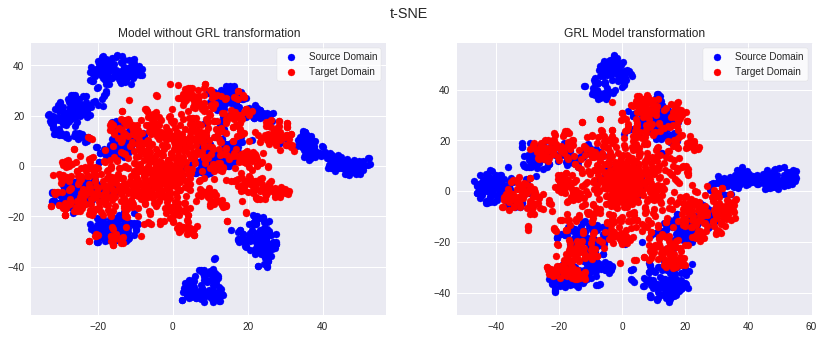

In [147]:
fig, axs = plt.subplots(1, 2, figsize=(14,5))

fig.suptitle('t-SNE')

axs[0].scatter(source_tsne_nogrl[:, 0], source_tsne_nogrl[:, 1], c='blue', label='Source Domain')
axs[0].scatter(target_tsne_nogrl[:, 0], target_tsne_nogrl[:, 1], c='red', label='Target Domain')
axs[0].set_title('Model without GRL transformation')
axs[0].legend(frameon=True, facecolor='white')

axs[1].scatter(source_tsne[:, 0], source_tsne[:, 1], c='blue', label='Source Domain')
axs[1].scatter(target_tsne[:, 0], target_tsne[:, 1], c='red', label='Target Domain')
axs[1].set_title('GRL Model transformation')
axs[1].legend(frameon=True, facecolor='white')

In [0]:
source_tsne_3D = TSNE(n_components=3).fit_transform(X[:, rand_idx].T)
target_tsne_3D = TSNE(n_components=3).fit_transform(X_m[:, rand_idx].T)

In [149]:
[x,y,z] = source_tsne_3D.T
trace1 = go.Scatter3d(x=x,y=y,z=z, mode='markers', marker=dict(
        size=12,line=dict(color='rgba(217, 217, 217, 0.14)',width=0.5),opacity=0.8))

[x2, y2, z2] = target_tsne_3D.T
trace2 = go.Scatter3d(x=x2,y=y2,z=z2,mode='markers',marker=dict(
        color='rgb(127, 127, 127)',size=12,symbol='circle',line=dict(color='rgb(204, 204, 204)',width=1),opacity=0.9))

data = [trace1, trace2]
layout = go.Layout(margin=dict(l=0,r=0,b=0,t=0))
fig = go.Figure(data=data, layout=layout)

plotly_plots.configure_plotly_browser_state()

init_notebook_mode(connected=False)

fig['layout'].update(height=800, width=1200)
plotly.offline.iplot(fig, filename='basic-line')